## Reachability for quadratic ODEs

Let $x'(t) = f(x)= ax^2(t) + bx(t) + c$, with $a, b, c \in \mathbb{R}$. We are interested in computing an overapproximation of the flowpipe in a finite time-span $t \in [0, T]$, given a set of initial states $x(0) \in \mathcal{X}_0 \subset {R}$.

The approach taken in this notebook is to use *conservative linearization* and reachability of linear ODEs with uncertain inputs.

*Linearization.* Recall the linearization around $\tilde{x} \in \mathbb{R}$:

$$
x'(t) = f(\tilde{x}) + \dfrac{\partial f}{\partial x}_{\vert x = \tilde{x}}~(x - \tilde{x}) + \frac{1}{2}\dfrac{\partial^2 f}{\partial x^2}_{\vert x = \xi}(x - \tilde{x})^2,
$$
for some $\xi \in \{\tilde{x} + \alpha(x - \tilde{x}): \alpha \in [0, 1]\}.$

In our case,

$\dfrac{\partial f}{\partial x} = 2ax + b$ and $\dfrac{\partial^2 f}{\partial x^2} = 2a$.

so we get

$$
x'(t) = a\tilde{x}^2 + b\tilde{x} + c + (2a\tilde{x} + b) ~(x - \tilde{x}) + a(x - \tilde{x})^2 $$

$$
\Rightarrow \boxed{ x'(t) = \alpha x + \beta + L(x, \tilde{x}, \xi)} \\
$$
where
$$
\alpha := 2a\tilde{x} + b\\
 \beta := a\tilde{x}^2 + b\tilde{x} + c - ( 2a\tilde{x} + b) \tilde{x} = -a\tilde{x}^2 + c  \\
 L(x, \tilde{x}, \xi) := a(x - \tilde{x})^2
$$

We solve a linear reachability problem:

$$
x'(t) = \alpha x + \beta + u_L
$$

where $u_L := [-k_\theta, k_\theta]$, $k_\theta := (e^{\alpha \Delta} - 1)^{-1}~\alpha~\theta \Delta$.

where $\Delta$ is the step size that corresponds to the time span of the linear reachability integration.

## Example

*Validation.*

In [ ]:
# call INT post operator
#sol = post(INT(δ=...))

*Linearization point.* $X_0$ is given 

In [ ]:
using ReachabilityAnalysis, Plots

using LazySets: center
using ReachabilityAnalysis: set

In [ ]:
function _linearize(a, b, c, x̃)
    μ = a * x̃
    α = 2 * μ + b
    β = -μ * x̃ + c
    return α, β
end

In [ ]:
# Example
# --------
a = 1.0
b = 1.0
c = 1.0
f(x) = a*x^2 + b*x + c
Δ = 0.02
X0 = Interval(0.9, 1.1)

c0 = center(X0)[1] # mid
x̃ = c0 + Δ / 2 * f(c0)

α, β = linearize(a, b, c, x̃)

θ = 0.5
R̄err = Interval(-θ * Δ, θ * Δ)

kθ = 1 / (exp(α * Δ) - 1) * α * θ * Δ
L̄ = Interval(-kθ, kθ)

In [ ]:
function _solve(; α, β, L̄, X0, Δ, δ)
    sys = ConstrainedAffineControlContinuousSystem(hcat(α), hcat(1.0), vcat(β), Universe(1), Interval(0.0, 0.0))
    prob = @ivp(sys, x(0) ∈ X0);
    #prob = @ivp(x' = α * x + β + uL, x(0) ∈ X0, uL ∈ L̄)
    sol = solve(prob, tspan=(0.0, Δ), alg=INT(δ=δ))
end

In [ ]:
@time sol = _solve(α=α, β=α, L̄=L̄, X0=X0, Δ=Δ, δ=Δ/10);

In [ ]:
R̂lin = ConvexHullArray([set(R) for R in sol]) ⊕ R̄err;
R̂lin_int = overapproximate(R̂lin, Interval)

In [ ]:
L = a * (R̂lin_int.dat - x̃)^2 |> Interval

In [ ]:
L ⊆ L̄

## Implementation

In [1]:
using ReachabilityAnalysis, Plots

using LazySets: center
using ReachabilityAnalysis: set

In [2]:
const RA = ReachabilityAnalysis
const IA = IntervalArithmetic

using ReachabilityAnalysis: post
using ReachabilityAnalysis: WaitingList, StateInLocation, state

In [3]:
function _expansion_point(a, b, c, X0::Interval, Δ)
    c₀ = mid(X0.dat)
    f_c₀ = c₀*(a*c₀ + b) + c
    x̃ = c₀ + Δ / 2 * f_c₀
    return x̃
end

_expansion_point (generic function with 1 method)

In [4]:
function _linearize(a, b, c, x̃)
    μ = a * x̃
    α = 2 * μ + b
    β = -μ * x̃ + c
    return α, β
end

_linearize (generic function with 1 method)

In [22]:
function solve_quadratic(; a, b, c, # f(x) = ax^2 + bx + c
                           X0,      # initial set
                           T,       # time span: [0, T]
                           Δ,       # step size for NL reach
                           δ,       # step size for the linear reach
                           θ,       # remainder expansion
                           maxiter)       

    # total flowpipe
    FT = Flowpipe{Float64,ReachSet{Float64,Interval{Float64,IntervalArithmetic.Interval{Float64}}},Array{ReachSet{Float64,Interval{Float64,IntervalArithmetic.Interval{Float64}}},1}}
    Ftot = Vector{FT}()

    # initialization
    Δti = RA.zeroI # defines the initial time
    waiting_list = WaitingList([Δti], [StateInLocation(X0, 1)])
    R̄err = Interval(-θ * Δ, θ * Δ)

    k = 1
    ksplit = 0
    while !isempty(waiting_list)

        (Δti, elem) = pop!(waiting_list)
        X0 = state(elem)

        # compute expansion point
        x̃ = _expansion_point(a, b, c, X0, Δ) 

        # linearization
        α, β = _linearize(a, b, c, x̃)

        # solve linear reachability
        prob = @ivp(x' = α * x + β, x(0) ∈ X0)
        sol = post(INT(δ=δ), prob, IA.Interval(0.0, Δ), Δt0=Δti)

        # compute admissible linearization error
        kθ = 1 / (exp(α * Δ) - 1) * α * θ * Δ
        L̄ = Interval(-kθ, kθ)

        # estimate lagrange remainder TODO: optimize
        R̂lin = ConvexHullArray([set(R) for R in sol]) ⊕ R̄err
        R̂lin_int = overapproximate(R̂lin, Interval)
        L = a * (R̂lin_int.dat - x̃)^2 |> Interval

        # validate Lagrange remainder
        if L ⊆ L̄
           # println("k = $k, inclusion check succeeded")
            # if the inclusion check succeeded, add errors to each reach-set
            # for final storage 
            F = Flowpipe([ReachSet(Interval(set(R).dat + R̄err.dat), tspan(R)) for R in sol])
            push!(Ftot, F)

            # only add the final reach-set to the waiting list if we didn't hit the time horizon
            Rf = F[end]
            tf = tend(Rf)
            T <= tstart(Rf) && continue # TODO check
            elem = StateInLocation(set(Rf), 1)
            push!(waiting_list, tspan(Rf), elem)

        else
            ksplit += 1 
            # println("k = $k, inclusion check failed")
            # if the inclusion didn't succeed, split initial condition
            # and append left and right interval segments to the waiting list
            X0l, X0r = split(X0, 2)
            iteml = StateInLocation(X0l, 1)
            itemr = StateInLocation(X0r, 1)

            push!(waiting_list, Δti, iteml)
            push!(waiting_list, Δti, itemr)
        end
        
        k += 1
        if k > maxiter
            error("maximum number of iterations maxiter=$maxiter reached, try increasing `maxiter`")
        end
    end # while
    println("num splits = $ksplit")
    return HybridFlowpipe(Ftot)
end

solve_quadratic (generic function with 1 method)

In [6]:
sol = solve_quadratic(a=-1.0, b=1.0, c=0.0, X0=Interval(0.1, 0.1),
                      T=10.0, Δ=0.5, δ=0.01, θ=0.01, maxiter=10_000);

In [7]:
tspan(sol)

[0, 10.5001]

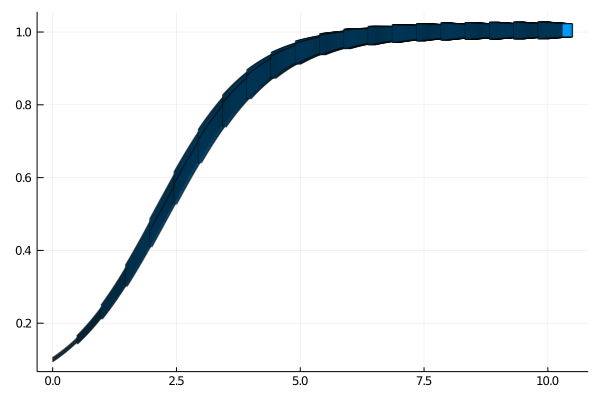

In [8]:
plot(sol, vars=(0, 1))

## Example

For $a, b \in \mathbb{R}_+$, let $x'(t) = ax^2 + bx$, $x(0) = x_0$. The solution is

$$
x(t) = \dfrac{u_0 b e^{bt}}{b + a(1-e^{bt})u_0}.
$$

In [9]:
a = -1.0
b = 1.0
u0 = 0.1
s(t) = u0 * b * exp(b*t) / (b + a*(1-exp(b*t))*u0)

s (generic function with 1 method)

In [10]:
using Plots

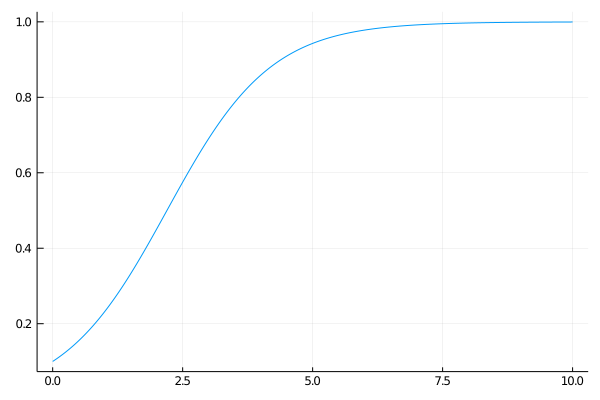

In [11]:
t = range(0.0, 10.0, step=0.005)
fig = plot(t, s.(t), lab="")

In [12]:
using BenchmarkTools

In [13]:
@btime sol = solve_quadratic(a=-1.0, b=1.0, c=0.0, X0=Interval(0.1, 0.1),
                             T=10.0, Δ=0.5, δ=0.01, θ=0.01, maxiter=10_000);

  1.027 ms (18643 allocations: 938.21 KiB)


In [31]:
sol = solve_quadratic(a=-1.0, b=1.0, c=0.0, X0=Interval(0.1, 0.1),
                      T=10.0, Δ=0.5, δ=0.1, θ=0.01, maxiter=20_000);
@show diameter(set(sol[end][end]))
@show numrsets(sol)
@show maximum(maximum(diameter(set(R)) for R in soli) for soli in sol)

num splits = 20
diameter(set((sol[end])[end])) = 0.163999628517282
numrsets(sol) = 2235
maximum((maximum((diameter(set(R)) for R = soli)) for soli = sol)) = 0.18326031513194585


0.18326031513194585

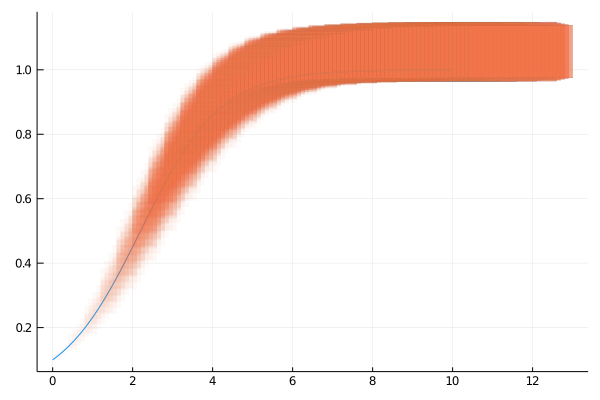

In [32]:
plot!(deepcopy(fig), sol, vars=(0, 1), lw=0.1, alpha=0.05)

In [104]:
length(sol)

53

In [105]:
(0.2 / 0.01)

20.0

In [106]:
(10 / 0.02) * 20

10000.0

In [107]:
length(sol)

53

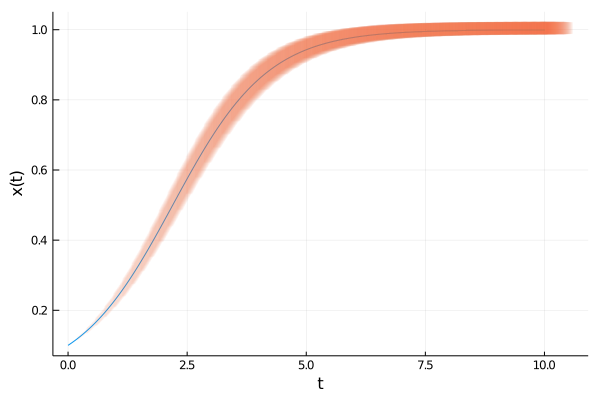

In [108]:
plot!(deepcopy(fig), sol, vars=(0, 1), lw=0.0, alpha=0.05, xlab="t", ylab="x(t)")

Initial condition `X0=Interval(0.1, 0.1)`.

|Δ|δ|θ|Max diam.|Final diam.|Num rsets|Runtime (ms)|Alloc|
|---|---|---|----|-----|--------|----|---|
|0.01| 0.0005|0.001|0.0404|0.002768|21 060| 26.7|313808 allocations: 18.73 MiB|
|0.05| 0.0005|0.001|0.0138|0.002618|20 300| 6.45|157945 allocations: 6.62 MiB|
|0.05| 0.0001|0.001|0.0855|0.00218|100 500| 13.3|638789 allocations: 21.29 MiB|
|0.2| 0.01|0.01|0.1107|0.0333|1060| 1.29|15803 allocations: 964.71 KiB|
|0.5| 0.01|0.01|0.06684|0.0359|1900| 1.066|18643 allocations: 938.21 KiB|

In [ ]:
sol = solve_quadratic(a=-1.0, b=1.0, c=0.0, X0=Interval(0.1, 0.5),
                             T=10.0, Δ=0.1, δ=0.01, θ=0.005, maxiter=10000);

In [ ]:
length(sol)

In [ ]:
0.1 / 0.01

In [ ]:
plot(sol[1], vars=(0, 1))
#plot!(sol[2], vars=(0, 1))

In [ ]:
plot(sol[2], vars=(0, 1))

## Improved version

In [147]:
IA.Interval(0, 1) ⊆ IA.Interval(0, 2)

true

In [156]:
function solve_quadratic_v2(; a, b, c, # f(x) = ax^2 + bx + c
                           X0,      # initial set
                           T,       # time span: [0, T]
                           Δ,       # step size for NL reach
                           δ,       # step size for the linear reach
                           θ,       # remainder expansion
                           maxiter)       

    # total flowpipe
    N = Float64
    ST = ReachSet{N,Interval{N,IA.Interval{N}}}
    VRT = Vector{ST}
    FT = Flowpipe{N, ST, VRT}
    Ftot = Vector{FT}()
    sizehint!(Ftot, ceil(Int, T / Δ))

    # initialization
    Δti = RA.zeroI # defines the initial time
    waiting_list = WaitingList([Δti], [StateInLocation(X0, 1)])
    R̄err = Interval(-θ * Δ, θ * Δ)
    Δint = IA.Interval(0.0, Δ)
    
    # number of reach-sets in each flowpipe
    NSTEPS = ceil(Int, Δ / δ)
    Fcurr = Vector{ST}(undef, NSTEPS)

    k = 1
    ksplit = 0
    while !isempty(waiting_list)

        (Δti, elem) = pop!(waiting_list)
        X0 = state(elem)

        # compute expansion point
        x̃ = _expansion_point(a, b, c, X0, Δ) 

        # linearization
        α, β = _linearize(a, b, c, x̃)

        # solve linear reachability
        prob = @ivp(x' = α * x + β, x(0) ∈ X0)
        sol = post(INT(δ=δ), prob, Δint, Δt0=Δti)

        # compute admissible linearization error
        kθ = 1 / (exp(α * Δ) - 1) * α * θ * Δ
        L̄ = Interval(-kθ, kθ)

        # estimate lagrange remainder
        maxbound = -Inf 
        minbound = Inf
        @inbounds for i in 1:NSTEPS

            X = set(sol[i]).dat + R̄err.dat |> Interval
            Fcurr[i] = ReachSet(X, tspan(sol[i]))
            
            max_X = max(X)
            min_X = min(X)

            if max_X > maxbound
                maxbound = max_X
            end

            if min_X < minbound
                minbound = min_X
            end
        end

        R̂lin_int = IA.Interval(minbound, maxbound)
        L = a * (R̂lin_int - x̃)^2 |> Interval
        
        # validate Lagrange remainder
        if L ⊆ L̄
           # println("k = $k, inclusion check succeeded")
            # if the inclusion check succeeded, add errors to each reach-set
            # for final storage 
            push!(Ftot, Flowpipe(copy(Fcurr)))

            # only add the final reach-set to the waiting list if we didn't hit the time horizon
            Rf = Fcurr[end]
            tf = tend(Rf)
            T <= tstart(Rf) && continue # TODO check
            elem = StateInLocation(set(Rf), 1)
            push!(waiting_list, tspan(Rf), elem)

        else
            ksplit += 1 
            # println("k = $k, inclusion check failed")
            # if the inclusion didn't succeed, split initial condition
            # and append left and right interval segments to the waiting list
            X0l, X0r = split(X0, 2)
            iteml = StateInLocation(X0l, 1)
            itemr = StateInLocation(X0r, 1)

            push!(waiting_list, Δti, iteml)
            push!(waiting_list, Δti, itemr)
        end
        
        k += 1
        if k > maxiter
            error("maximum number of iterations maxiter=$maxiter reached, try increasing `maxiter`")
        end
    end # while
   # println("num splits = $ksplit")
    return HybridFlowpipe(Ftot)
end

solve_quadratic_v2 (generic function with 1 method)

In [164]:
@btime sol = solve_quadratic_v2(a=-1.0, b=1.0, c=0.0, X0=Interval(0.1, 0.1),
                                T=10.0, Δ=0.5, δ=0.01, θ=0.01, maxiter=10_000);

  1.825 ms (45144 allocations: 1.69 MiB)


In [205]:
sol = solve_quadratic_v2(a=-1.0, b=1.0, c=0.0, X0=Interval(0.1, 0.1),
                         T=10.0, Δ=0.05, δ=0.001, θ=0.01, maxiter=10_000);
@show diameter(set(sol[end][end]))
@show numrsets(sol)
@show maximum(maximum(diameter(set(R)) for R in soli) for soli in sol)

diameter(set((sol[end])[end])) = 0.022129550556678534
numrsets(sol) = 10250
maximum((maximum((diameter(set(R)) for R = soli)) for soli = sol)) = 0.08626030475034008


0.08626030475034008

In [206]:
plot(sol, vars=(0, 1))

<!DOCTYPE html>
 
 
 Plots.jl

## TMJets

In [33]:
# a = -1.0, b = 1.0, c = 0.0
@taylorize function quadr!(du, u, p, t)
    x = u[1]
    aux = -x + 1.0
    du[1] = aux*x
end

In [34]:
probq = @ivp(x' = quadr!(x), dim: 1, x(0) ∈ Interval(0.1, 0.1))

InitialValueProblem{BlackBoxContinuousSystem{typeof(quadr!)},Interval{Float64,IntervalArithmetic.Interval{Float64}}}(BlackBoxContinuousSystem{typeof(quadr!)}(quadr!, 1), Interval{Float64,IntervalArithmetic.Interval{Float64}}([0.1, 0.100001]))

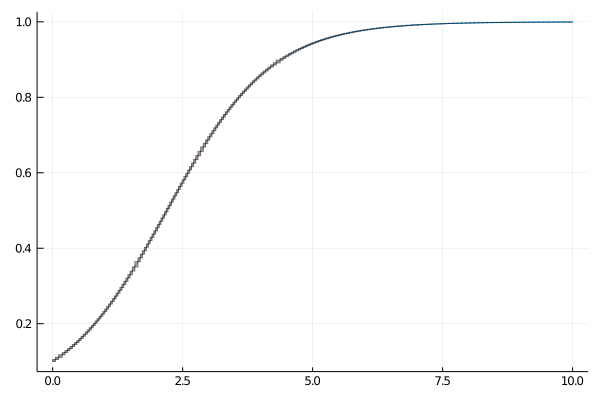

In [38]:
solq = solve(probq, T=10.0, alg=TMJets(abs_tol=1e-14))
solqz = overapproximate(solq, Zonotope)
plot!(deepcopy(fig), solqz, vars=(0, 1))

In [39]:
@btime solve($probq, T=10.0, alg=TMJets(abs_tol=1e-14));

  150.097 ms (2047496 allocations: 180.08 MiB)


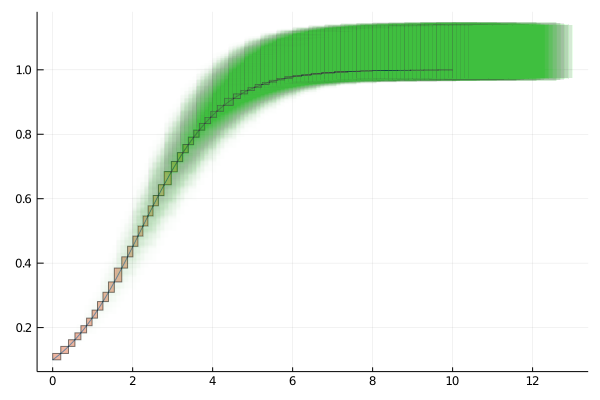

In [37]:
plot!(sol, vars=(0, 1), lw=0.0, alpha=.01)